In [1]:
# ! kaggle datasets download dayiyao/celeba-dataset
# ! unzip celeba-dataset.zip -d datasets

# ДЗ 4. Диффузия
В этой домашке вам предстоит обучить DDPM на пресловутых лицах (CelebA 32х32). Решением является решенный ноутбук с обучением модели, сгенерированными картинками и, по требованию проверяющего, чекпоинтами

In [2]:
import einops
import os
import random
import imageio
import numpy as np
from argparse import ArgumentParser


from tqdm.auto import tqdm
import matplotlib.pyplot as plt

import torch
import torch.nn as nn
from torch.optim import Adam
from torch.utils.data import DataLoader

from torchvision.transforms import Compose, ToTensor, Lambda, Resize
from torchvision.datasets.mnist import MNIST, FashionMNIST
from celeba import CelebADataset as CelebA
from torchvision import transforms

/home/sudakovcom/Desktop/celeba-DDPM/.conda/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


# Визуализация данных

In [3]:
def show_images(images, title=""):
    """Shows the provided images as sub-pictures in a square"""
    if type(images) is torch.Tensor:
        images = images.detach().cpu().permute(0,2,3,1).numpy()

    fig = plt.figure(figsize=(8, 8))
    rows = int(len(images) ** (1 / 2))
    cols = round(len(images) / rows)

    idx = 0
    for r in range(rows):
        for c in range(cols):
            fig.add_subplot(rows, cols, idx + 1)

            if idx < len(images):
                plt.imshow((images[idx].clip(-1,1) * 127.5 + 128).astype('uint8'))
                idx += 1
    fig.suptitle(title, fontsize=30)

    plt.show()

In [4]:
def show_first_batch(loader):
    for batch in loader:
        show_images(batch, "Первый батч")
        break

## Загрузка данных (0 баллов)

Мы будем использовать CelebA (32x32). **Важно**: отнормируйте данные в интервал `[-1,1]`.

In [5]:
batch_size = 256
image_size = 32

transform=transforms.Compose([
    transforms.Resize(image_size),
    transforms.CenterCrop(image_size),
    transforms.ToTensor(),
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.Normalize(mean=[0.5, 0.5, 0.5],
                          std=[0.5, 0.5, 0.5])
])
dataset = CelebA(transform=transform)
loader = DataLoader(dataset, batch_size, shuffle=True)

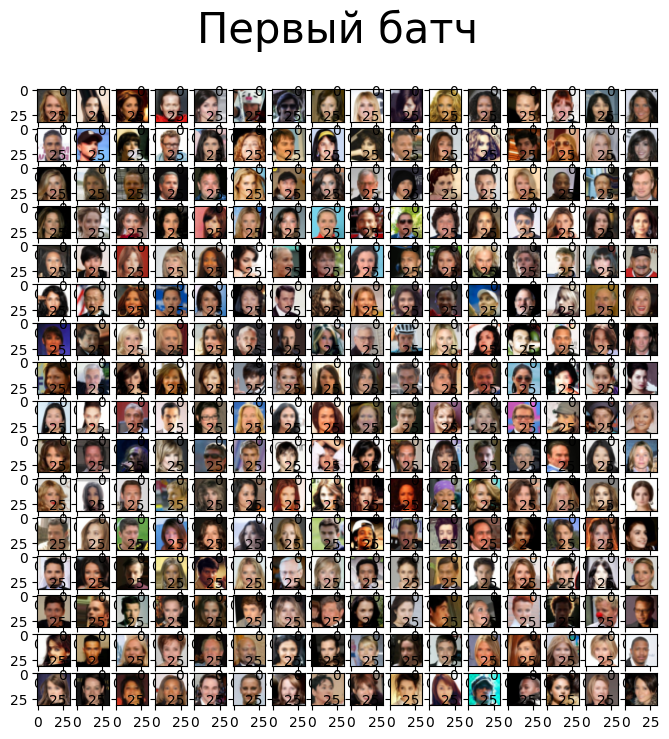

In [6]:
show_first_batch(loader)

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}\t" + (f"{torch.cuda.get_device_name(0)}" if torch.cuda.is_available() else "CPU"))

Using device: cuda	NVIDIA GeForce RTX 3060


# Denoising Diffusion Model (DDPM) (2 балла)

## Recap
Диффузия - это обратимый стохастический процесс, в котором картинка зашумляется по известному гауссовскому закону $q(x_t|x_{t-1})$ и денойзится по неизвестному обратному гауссовскому закону $p(x_{t-1}|x_t)$, который приближается нейросетью $p_\theta$
![](https://lilianweng.github.io/posts/2021-07-11-diffusion-models/DDPM.png)

Известный закон $q$ (он же forward pass) описывается по формуле:
$$
\begin{aligned}
\mathbf{x}_t 
&= \sqrt{\alpha_t}\mathbf{x}_{t-1} + \sqrt{1 - \alpha_t}\boldsymbol{\epsilon}_{t-1} & \text{ ;where } \boldsymbol{\epsilon}_{t-1}, \boldsymbol{\epsilon}_{t-2}, \dots \sim \mathcal{N}(\mathbf{0}, \mathbf{I}) \\
&= \sqrt{\alpha_t \alpha_{t-1}} \mathbf{x}_{t-2} + \sqrt{1 - \alpha_t \alpha_{t-1}} \bar{\boldsymbol{\epsilon}}_{t-2} & \text{ ;where } \bar{\boldsymbol{\epsilon}}_{t-2} \text{ merges two Gaussians (*).} \\
&= \dots \\
&= \sqrt{\bar{\alpha}_t}\mathbf{x}_0 + \sqrt{1 - \bar{\alpha}_t}\boldsymbol{\epsilon} \\
q(\mathbf{x}_t \vert \mathbf{x}_0) &= \mathcal{N}(\mathbf{x}_t; \sqrt{\bar{\alpha}_t} \mathbf{x}_0, (1 - \bar{\alpha}_t)\mathbf{I})
\end{aligned}
$$, где $\alpha$ - заранее определенные по определенной сетке константы

Неизвестная же гауссиана обратного закона (он же backward pass) предсказывается нейросетью:
$p_\theta(x_{t-1}|x_t) = \mathcal{N}(x_{t-1};\mu_\theta(x_t, t),\sigma_\theta(x_t,t))$ (т.е. предсказываются $\mu$ и $\sigma$, 1в1 как в вариационном енкодере)

Кроме этого, так же, как в варэнкодере, $p_\theta$ выучивается максимизацией ELBO (и даже KL там тоже между двумя гауссианами)

Ну а выучив обратный процесс денойзинга $p_\theta(x_{t-1}|x_t)$, дело останется за малым: берём $x_T\sim\mathcal{N}(0,1)$ и семплируем $x_{t-1}\sim p_\theta(x_{t-1}|x_t)$, пока не восстановим наш незашумленный $x_0$. Это и будет какая-то картинка

## DDPM

С варвыводом вы уже хорошо знакомы, но авторы DDPM решили с ним не париться и забить на $\sigma_t$, сделав её заранее определённой константой, например:
- $\sigma_t^2$ = $\beta_t$
- $\sigma_t^2$ = $\frac{1 - \bar{\alpha_{t-1}}}{1 - \bar{\alpha_{t}}} \beta_t$

Тогда
$$q(x_{t-1}|x_0, x_t)=\mathcal{N}(x_{t-1}|\mu_t^q,\sigma_t)$$
$$p_\theta(x_{t-1}|x_t)=\mathcal{N}(x_{t-1}|\mu_t^\theta,\sigma_t)$$

Кроме этого, из вышеуказанного прямого закона $q$ несложно представить $\mu_t^q$ в виде 

$$\boldsymbol{\mu}^q_t = \frac{1}{\sqrt{\alpha_t}} \Big( \mathbf{x}_t - \frac{1 - \alpha_t}{\sqrt{1 - \bar{\alpha}_t}} \boldsymbol{\epsilon}_t \Big)$$

Так давайте представим и $\mu^\theta_t$ в таком виде, раз так:
$$\boldsymbol{\mu}^\theta_t = \frac{1}{\sqrt{\alpha_t}} \Big( \mathbf{x}_t - \frac{1 - \alpha_t}{\sqrt{1 - \bar{\alpha}_t}} \boldsymbol{\epsilon}_t^\theta(x_t,t) \Big)$$ 

Тогда весь $KL(q|p_\theta)$ сведётся к минимизации MSE

$$||\mu_t^q-\mu_t^\theta||^2\sim||\epsilon_t-\epsilon_t^\theta(x_t,t)||^2$$

Ну а зашумленный $x_t$ можно считать из исходного $x_0$ по быстрой формуле (см. самое начало):

$$x_t=\sqrt{\bar{\alpha}_t}\mathbf{x}_0 + \sqrt{1 - \bar{\alpha}_t}\boldsymbol{\epsilon}_t$$

$\epsilon_t$ же на деле берут случайно из $\mathcal{N}(0,1)$

Итого, все-эти-ваши диффузии можно представить в виде нескольких строк кода:
![](https://lilianweng.github.io/posts/2021-07-11-diffusion-models/DDPM-algo.png)

Прим. В качестве $\epsilon^\theta$ берут любой Unet-like бэкбон (кроме этого, есть оптимизированный под диффузию Efficient Unet)

Для большей инфы по диффузии идите сюда https://lilianweng.github.io/posts/2021-07-11-diffusion-models/


In [ ]:
class DDPM(nn.Module):
    def __init__(self, network,
                 n_steps=1000,
                 min_beta=1e-5,
                 max_beta=1e-2,
                 device=None,
                 image_chw=(3, image_size, image_size)):
        super().__init__()
        self.n_steps = n_steps
        self.device = device
        self.image_chw = image_chw
        self.network = network.to(device)
        self.betas = torch.linspace(-6, 6, n_steps).to(device)
        self.betas = torch.sigmoid(self.betas).to(device) * (max_beta - min_beta) + min_beta
        self.alphas = (1 - self.betas).to(device)
        self.alpha_bars = torch.cumprod(self.alphas, 0).to(device)

    def forward(self, x0, t, eta=None):
        if eta is None:
            eta = torch.randn_like(x0).to(device)
        alpha_bar = self.alpha_bars[t][:, None, None, None].to(device)
        noised_x = torch.sqrt(alpha_bar) * x0 + torch.sqrt(1 - alpha_bar) * eta
        return noised_x

    def backward(self, x, t):
        eta_pred = self.network(x, t)
        return eta_pred

## Visualizing forward and backward (2 балла)

In [ ]:
def show_forward(ddpm, loader, device):
    for batch in loader:
        imgs = batch.to(device)

        show_images(imgs, "Original images")

        for percent in [0.25, 0.5, 0.75, 1]:
            noised_images = ddpm.forward(imgs, torch.ones(imgs.shape[0], dtype=torch.int)*int(percent * (ddpm.n_steps-1)))
            show_images(
                noised_images,
                f"DDPM Noisy images {int(percent * 100)}%"
            )
        break

In [ ]:
def generate_new_images(ddpm, n_samples=16, device=None, frames_per_gif=100,
                        gif_name="sampling.gif", c=3, h=image_size, w=image_size):
    """Given a DDPM model, a number of samples to be generated and a device, returns some newly generated samples"""
    frame_idxs = np.linspace(0, ddpm.n_steps, frames_per_gif).astype(np.uint)
    frames = []

    with torch.no_grad():
        if device is None:
            device = ddpm.device

        x = torch.randn(n_samples, c, h, w).to(device)

        for idx, t in enumerate(range(ddpm.n_steps - 1, -1, -1)):
            time_tensor = torch.ones(n_samples).long().to(device)*t
            eta_theta = ddpm.backward(x, time_tensor)

            alpha_t = ddpm.alphas[t].to(device)
            alpha_t_bar = ddpm.alpha_bars[t].to(device)
            beta_t = ddpm.betas[t].to(device)

            x = 1 / torch.sqrt(alpha_t) * (x - (1 - alpha_t) / torch.sqrt(1 - alpha_t_bar) * eta_theta)

            if t > 0:
                z = torch.randn(n_samples, c, h, w).to(device)

                sigma_t = torch.sqrt(beta_t)

                x = x + sigma_t * z

            if idx in frame_idxs or t == 0:
                normalized = x.clone()
                normalized = (normalized.clamp(-1,1) * 127.5 + 128).to(torch.uint8)

                frame = einops.rearrange(normalized, "(b1 b2) c h w -> (b1 h) (b2 w) c", b1=int(n_samples ** 0.5))
                frame = frame.cpu().numpy().astype(np.uint8)

                frames.append(frame)

    with imageio.get_writer(gif_name, mode="I") as writer:
        for idx, frame in enumerate(frames):
            writer.append_data(frame)
            if idx == len(frames) - 1:
                for _ in range(frames_per_gif // 3):
                    writer.append_data(frames[-1])
    return x

# UNet backbone ($\epsilon^\theta$) (3 балла)

Как уже было сказано, в качестве $\epsilon^\theta$ подойдёт любой Unet-like бэкбон (который будет принимать на вход зашумлённую картинку и на выходе возвращать восстановленный шум $\epsilon_t$ той же размерности). Одна незадача - вторым аргументом $\epsilon^\theta$ принимает время (шаг зашумления) $t$, чего в ванильном Unet'e нет.

К счастью, есть миллион и один способ добавить время дополнительным аргументом (например, AdaIN, как в StyleGAN, дополнительным каналом и т.д.)

На практике же в DDPM делают positional encoding (тот самый, который в Трансформере) времени $t$ и дальше просто плюсуют его прямо к входной картинке $x$. Мало того, вместе в временем иногда ещё и какие-нибудь текстовые эмбединги приплюсовывают (сжимая их нехитрым образом до нужной размерности через дополнительный линейный слой)

С текстовыми эмбедингами мы работать в этой домашке не будем, а вот $t$ добавлять будем ровно последним способом 

In [11]:
from networks import SongUNet

net = SongUNet(
    img_resolution=image_size,
    in_channels=3,
    out_channels=3,
    num_blocks=2,
    model_channels=32, 
    channel_mult=[2,2],
)

net.train().cuda()

print(f"Модель имеет {sum(p.numel() for p in net.parameters())} параметров")

Модель имеет 1486595 параметров


In [ ]:
n_steps, min_beta, max_beta = 1000, 1e-5, 1e-2
ddpm = DDPM(net, n_steps=n_steps, min_beta=min_beta, max_beta=max_beta, device=device)

# Обучение (1 балл)
![](https://lilianweng.github.io/posts/2021-07-11-diffusion-models/DDPM-algo.png)

In [ ]:
def training_loop(ddpm, loader, n_epochs, optim, device, display=True, store_path="ddpm_model.pt"):
    mse = nn.MSELoss()
    best_loss = float("inf")
    n_steps = ddpm.n_steps

    for epoch in range(n_epochs):
        epoch_loss = 0.0
        for step, batch in enumerate(tqdm(loader, leave=False, desc=f"Epoch {epoch + 1}/{n_epochs}", colour="#005500")):
            x0 = batch.to(device)
            
            eta = torch.randn_like(x0).to(device)
            t = torch.randint(0, n_steps, size = (x0.shape[0],)).to(device).long()
            

            noisy_imgs = ddpm.forward(x0, t, eta)

            eta_theta = ddpm.backward(noisy_imgs, t)

            loss = mse(eta, eta_theta)
            optim.zero_grad()
            loss.backward()
            optim.step()

            epoch_loss += loss.item() * len(x0) / len(loader.dataset)

        if display:
            show_images(generate_new_images(ddpm, device=device), f"Images generated at epoch {epoch + 1}")

        log_string = f"Loss at epoch {epoch + 1}: {epoch_loss:.3f}"

        # Storing the model
        if best_loss > epoch_loss:
            best_loss = epoch_loss
            torch.save(ddpm.state_dict(), store_path)
            log_string += " --> Best model ever (stored)"

        print(log_string)

In [16]:
store_path = "checkpoints/celeba_ddpm.ckpt"

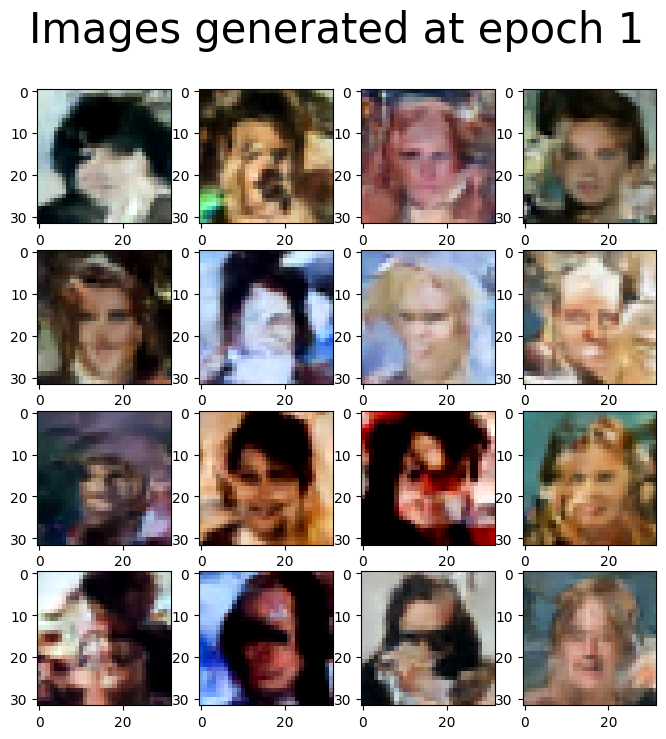

Loss at epoch 1: 0.123 --> Best model ever (stored)


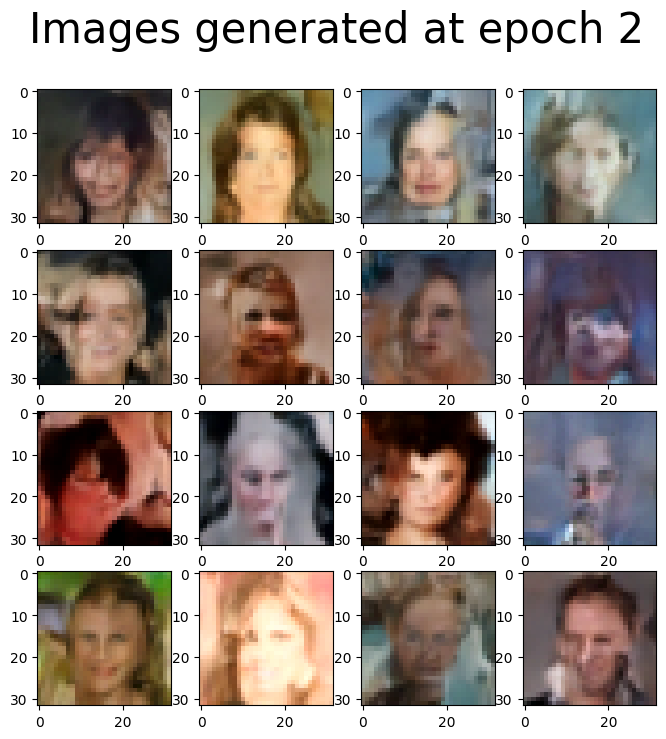

Loss at epoch 2: 0.082 --> Best model ever (stored)


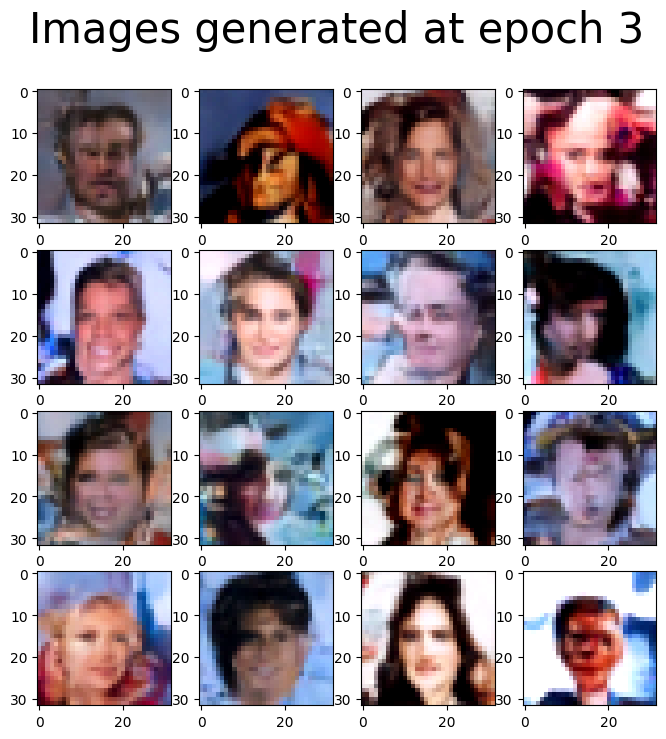

Loss at epoch 3: 0.078 --> Best model ever (stored)


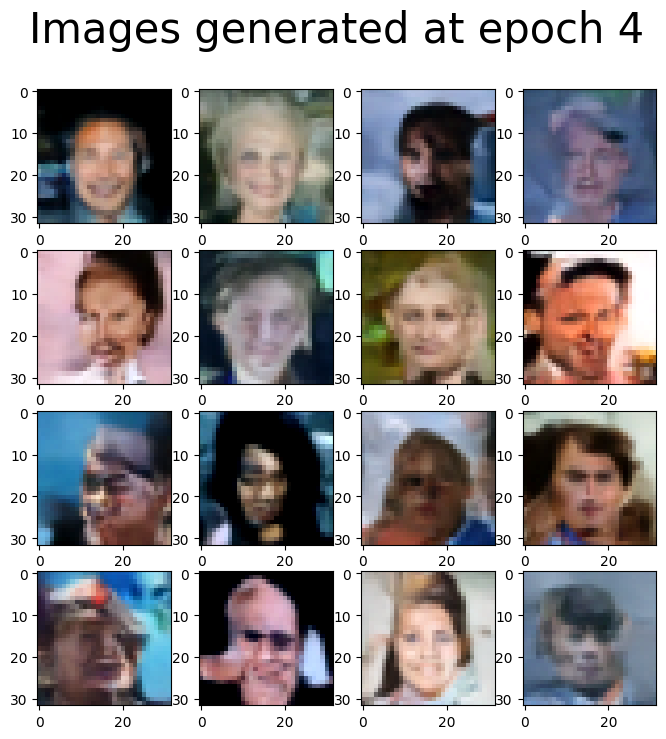

Loss at epoch 4: 0.076 --> Best model ever (stored)


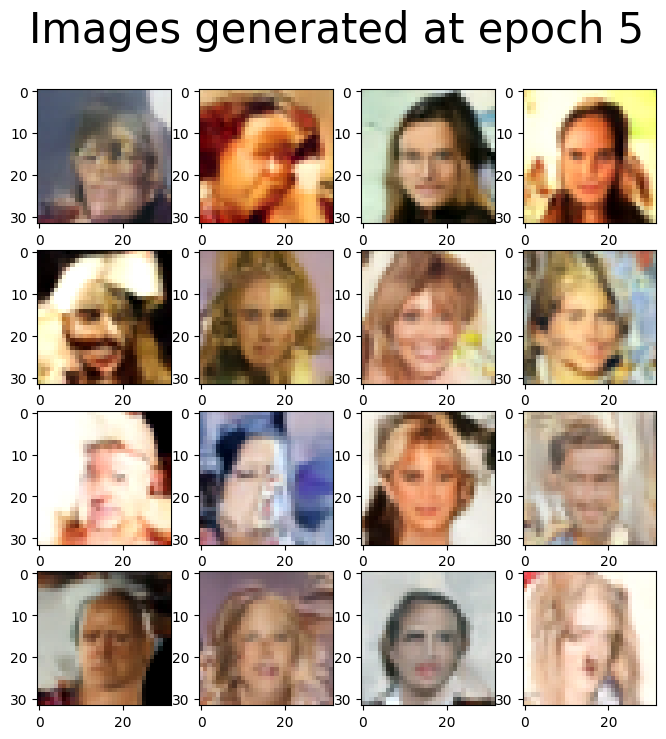

Loss at epoch 5: 0.075 --> Best model ever (stored)


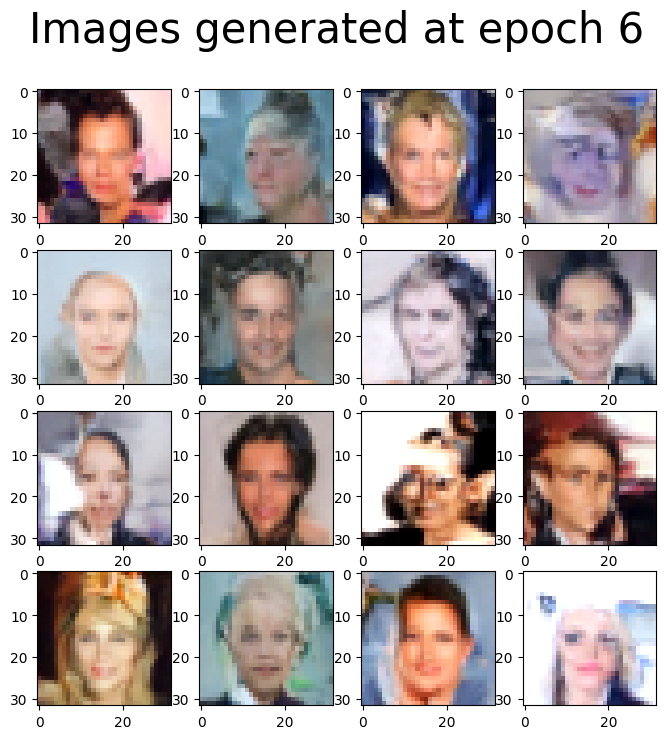

Loss at epoch 6: 0.074 --> Best model ever (stored)


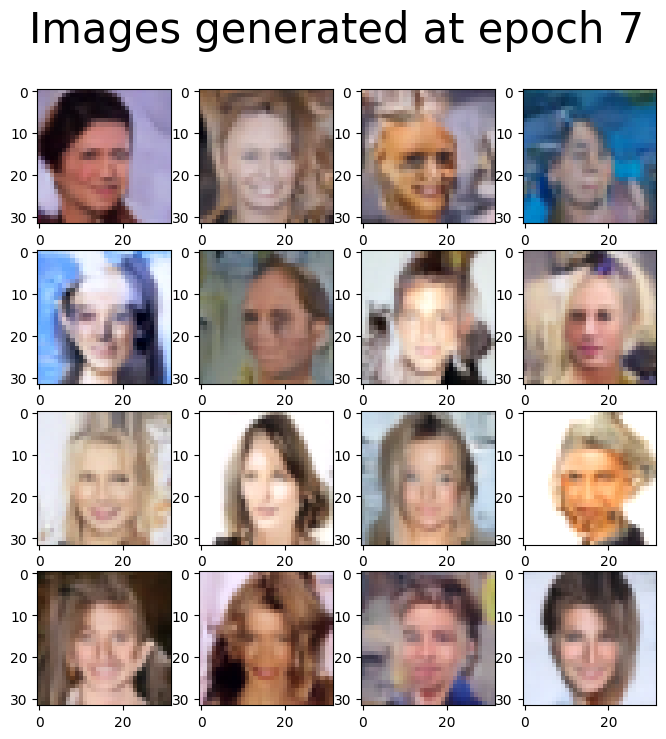

Loss at epoch 7: 0.074 --> Best model ever (stored)


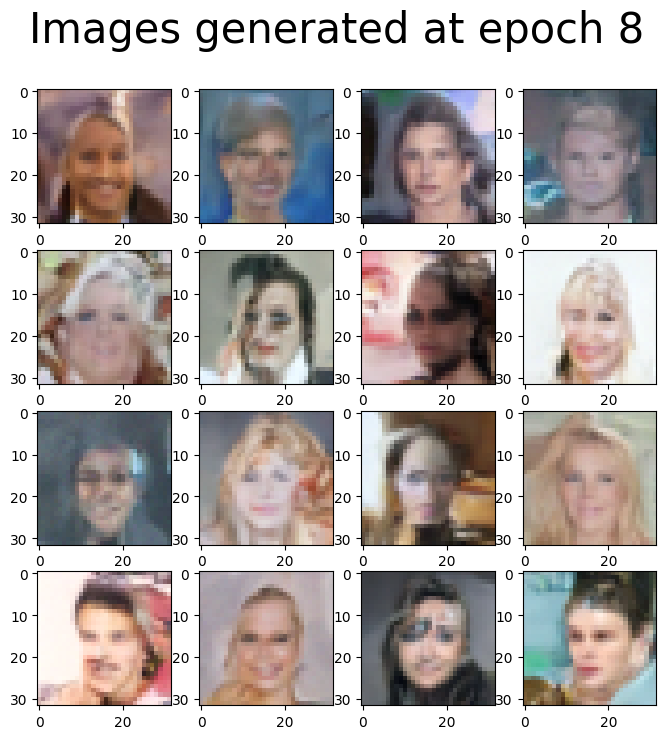

Loss at epoch 8: 0.073 --> Best model ever (stored)


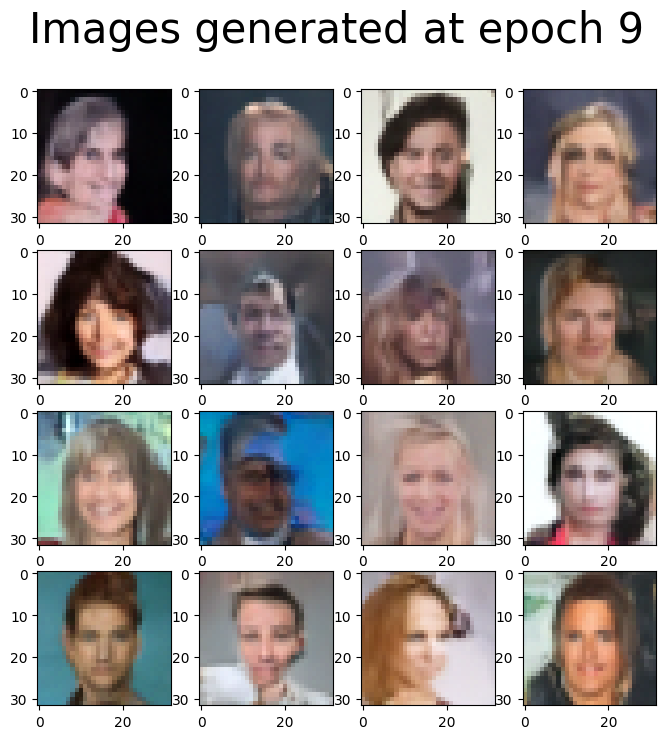

Loss at epoch 9: 0.072 --> Best model ever (stored)


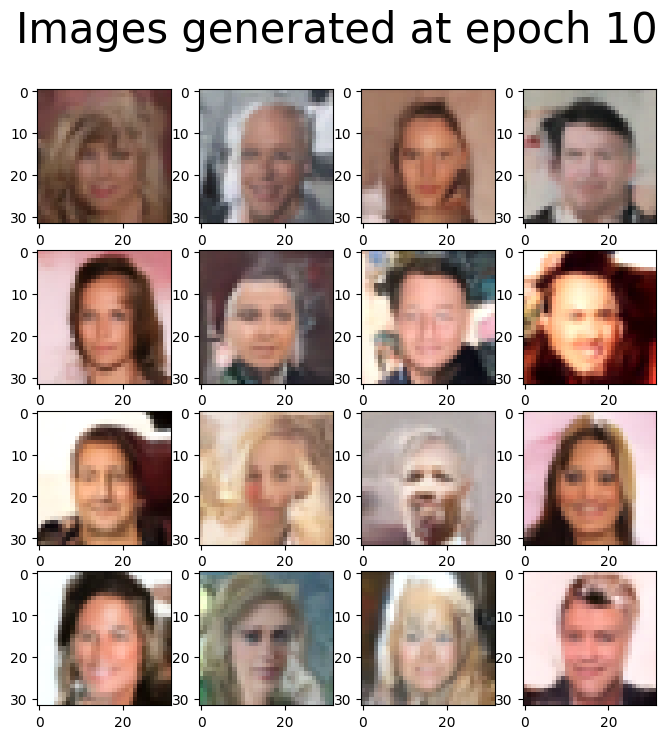

Loss at epoch 10: 0.072 --> Best model ever (stored)


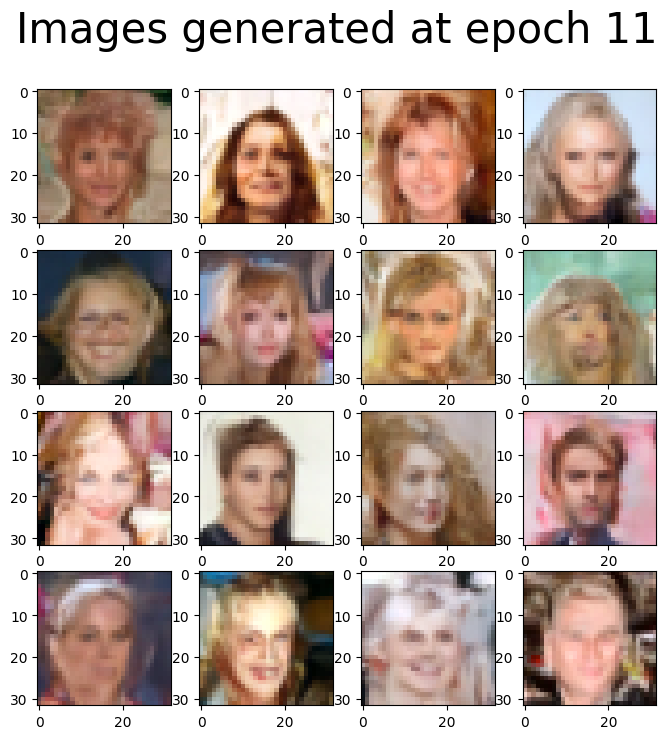

Loss at epoch 11: 0.072 --> Best model ever (stored)


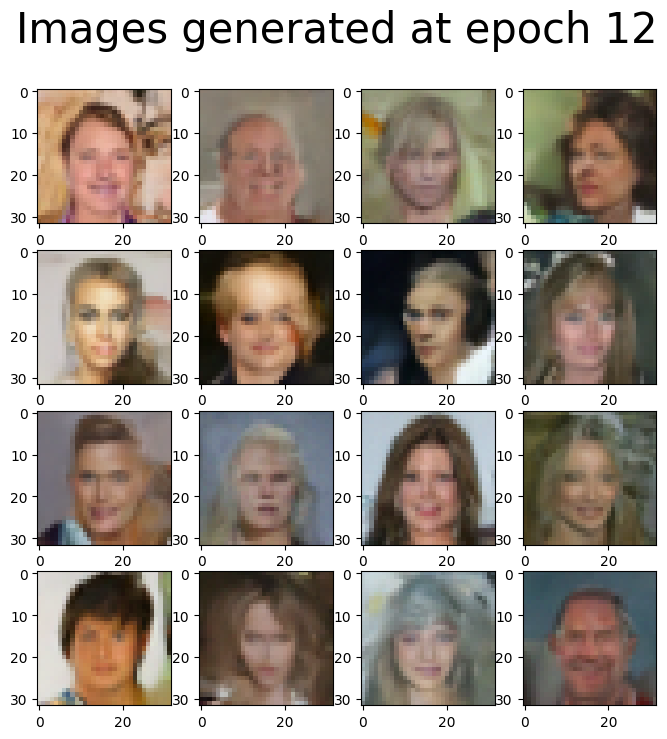

Loss at epoch 12: 0.071 --> Best model ever (stored)


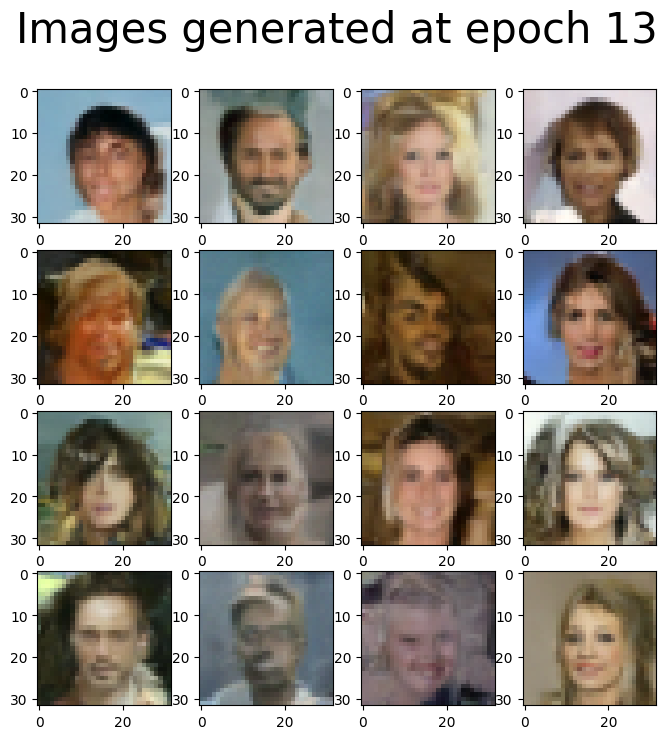

Loss at epoch 13: 0.071 --> Best model ever (stored)


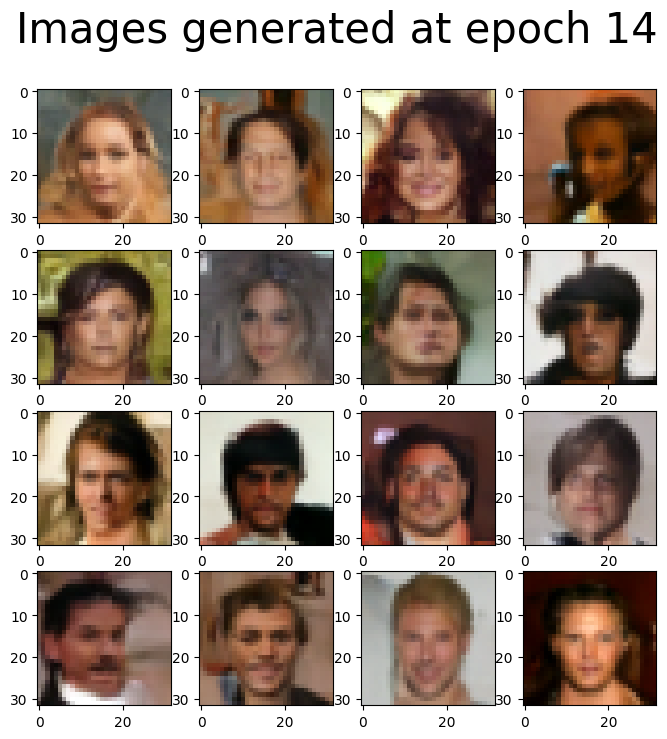

Loss at epoch 14: 0.071 --> Best model ever (stored)


KeyboardInterrupt: 

In [18]:
# Training
n_epochs = 1000
lr = 3e-4
if not os.path.isdir(os.path.dirname(store_path)): os.mkdir(os.path.dirname(store_path))
training_loop(ddpm, loader, n_epochs, optim=Adam(ddpm.parameters(), lr), device=device, store_path=store_path)

# Генерёжка (2 балла за хорошие картинки)

In [20]:
# Loading the trained model
ddpm.load_state_dict(torch.load(store_path, map_location=device))
print("Model loaded")

Model loaded


Generating new images


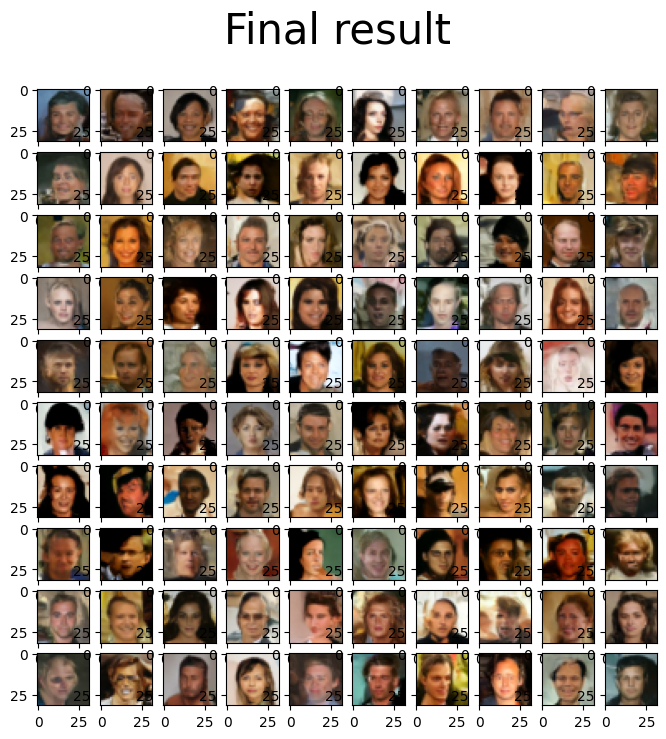

In [22]:
print("Generating new images")
generated = generate_new_images(
        ddpm,
        n_samples=100,
        device=device,
        gif_name="celeba.gif"
    )
show_images(generated, "Final result")

# Visualizing the diffusion

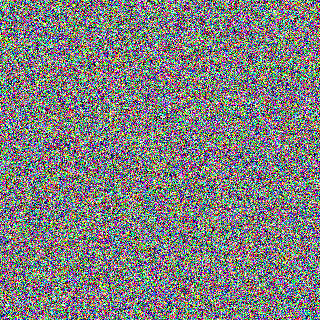

In [23]:
from IPython.display import Image

Image(open('celeba.gif','rb').read())